# Recognition pipeline

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import PIL.Image
import pandas as pd
import cv2
from math import floor
import numpy as np
import os
import matplotlib.pyplot as plt
from recognition_functions import *
from plot_helper import *
from table_extractor import *
from chip_recognition import *
from collections import defaultdict

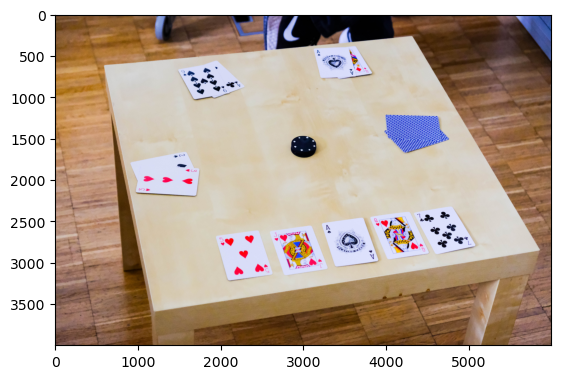

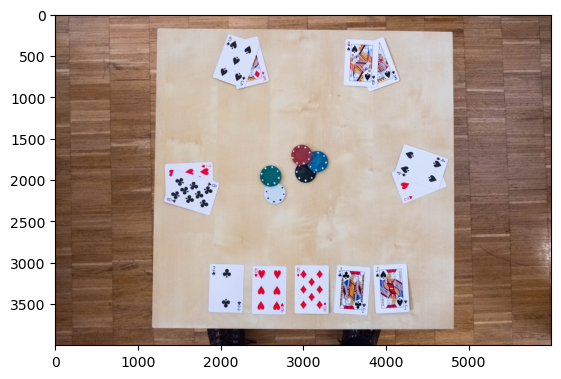

In [3]:
path_data = "data/train"
path_setup = "data/image_setup/"

file = os.path.join(path_data, f"train_{str(0).zfill(2)}.jpg")
file_xtrem = os.path.join(path_setup, "ultimate_test.jpg")

# open the image
im_xtrem = PIL.Image.open(file_xtrem)
plt.imshow(im_xtrem)
plt.show()

# open the image
im = PIL.Image.open(file)
plt.imshow(im)
plt.show()

### Read images

In [4]:
images = []

for i in range(28):
    #if i not in problematic_imgs:
    file = os.path.join(path_data, f"train_{str(i).zfill(2)}.jpg")
    im = PIL.Image.open(file)
    images.append(np.array(im))

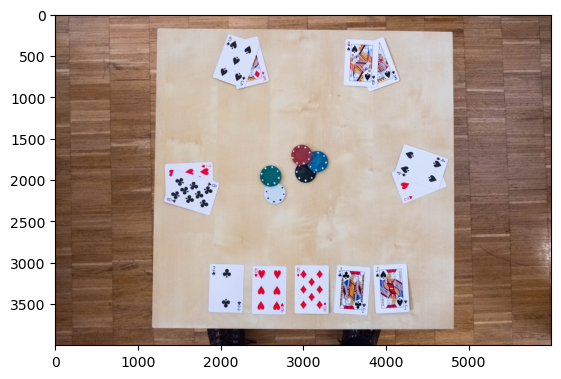

In [5]:
plt.imshow(images[0])
plt.show()

### Extract table

In [6]:
table_imgs = []
for img in images:
    table_img = TableExtractor.extract_table(img,plot=False)
    table_imgs.append(table_img)

### Partition image

In [7]:
partitions = []
for table_img in table_imgs:
    partition = partition_image(table_img)
    partitions.append(partition)

In [8]:
chips_imgs = []
for i in range(len(table_imgs)):
    chips_imgs.append(partitions[i]["chips"])

In [23]:
def brightness_stats(img):
    img_hsv = cv2.cvtColor(img, cv2.COLOR_RGB2HSV)
    h,s,v = cv2.split(img_hsv)
    return v.mean(), v.std()

In [24]:
total_mean = 0
total_std = 0
for c in chips_imgs:
    mean, std = brightness_stats(c)
    
    total_mean += mean
    total_std += std
    
(total_mean/len(chips_imgs), total_std/len(chips_imgs))

(209.89224681440444, 26.869416102485868)

In [68]:
def normalize_brightness(img):
    V_MEAN = 180.0
    V_STD = 47.0
    
    img_v_mean, img_v_std = brightness_stats(img)
    
    img_hsv = cv2.cvtColor(img, cv2.COLOR_RGB2HSV)
    h,s,v = cv2.split(img_hsv.astype("float32"))
    
    v -= img_v_mean
    v *= (img_v_std / V_STD)
    v += V_MEAN
    v = np.clip(v, 0, 255)
    
    transfer = cv2.merge([h, s, v])
    transfer = cv2.cvtColor(transfer.astype("uint8"), cv2.COLOR_HSV2RGB)
    
    return transfer

In [70]:
aligned_norm_bright = []
for c in chips_imgs:
    new_c = normalize_brightness(c)
    aligned_norm_bright.append(new_c)

float32
float32
float32
float32
float32
float32
float32
float32
float32
float32
float32
float32
float32
float32
float32
float32
float32
float32
float32
float32
float32
float32
float32
float32
float32
float32
float32
float32


### Align image brightness

In [ ]:
from PIL import Image, ImageEnhance, ImageStat

aligned = []
MEAN_BRIGHTNESS = 190

for c in chips_imgs:
    
    print("Original image")
    plt.imshow(c)
    plt.show()
    
    gray = cv2.cvtColor(c, cv2.COLOR_BGR2GRAY)
    flag, thresh = cv2.threshold(gray, 0, 255, cv2.THRESH_OTSU)

    bin_tresh = thresh > 0

    
    background_img = Image.fromarray(c[bin_tresh]).convert('L')
    
    stat = ImageStat.Stat(background_img)
    
    img = Image.fromarray(c)
    img_brightness_obj = ImageEnhance.Brightness(img)
    
    
    factor= 1 / (stat.mean[0] / MEAN_BRIGHTNESS)
    print(factor)
        
    enhanced_img=img_brightness_obj.enhance(factor)
    
    aligned.append(np.array(enhanced_img))

    plt.imshow(np.array(enhanced_img))
    plt.show()

In [ ]:
def equalize_img(img, plot=False):
   
    r_image, g_image, b_image = cv2.split(img)

    r_image_eq = cv2.equalizeHist(r_image)
    g_image_eq = cv2.equalizeHist(g_image)
    b_image_eq = cv2.equalizeHist(b_image)

    image_eq = cv2.merge((r_image_eq, g_image_eq, b_image_eq))
    
    if plot:
        fig = plt.figure(figsize=(10, 20))

        ax1 = fig.add_subplot(2, 2, 1)
        ax1.axis("off")
        ax1.title.set_text('Original')
        ax2 = fig.add_subplot(2, 2, 2)
        ax2.axis("off")
        ax2.title.set_text("Equalized")

        ax1.imshow(img)
        ax2.imshow(image_eq)
        plt.show()
        return True
    return image_eq

In [ ]:
from color_alignment import color_transfer

In [ ]:
for c in aligned:
    
    target = aligned[0]
    gray = cv2.cvtColor(target, cv2.COLOR_BGR2GRAY)
    flag, thresh = cv2.threshold(gray, 0, 255, cv2.THRESH_OTSU)

    bin_tresh = thresh > 0
    
    back_img = target[bin_tresh]
    back_img = back_img.reshape(1,-1,3)
    print()

    new_c = color_transfer(back_img,c)
    plt.imshow(new_c)
    plt.show()

### Align image mean rgb

In [26]:
total = np.zeros(3)
for c in chips_imgs:
    gray = cv2.cvtColor(c, cv2.COLOR_BGR2GRAY)
    flag, thresh = cv2.threshold(gray, 0, 255, cv2.THRESH_OTSU)

    bin_tresh = thresh > 0

    total += c[bin_tresh].mean(axis=0)
    
ref = total / len(chips_imgs)
ref

array([216.05053233, 199.19974047, 178.16692084])

array([216.05053233, 199.19974047, 178.16692084])

array([216.05053233, 199.19974047, 178.16692084])

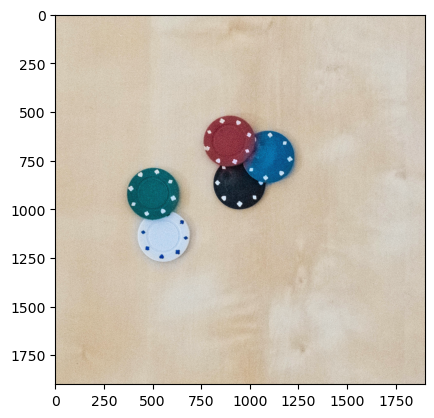

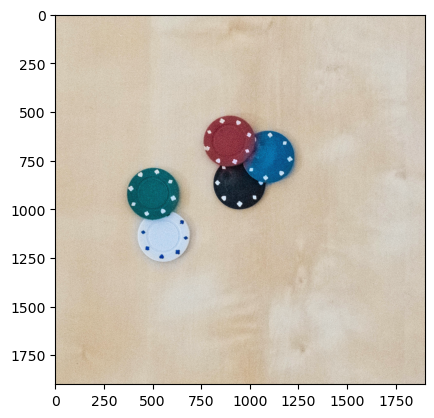

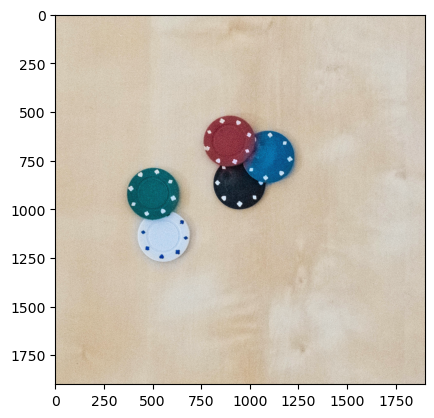

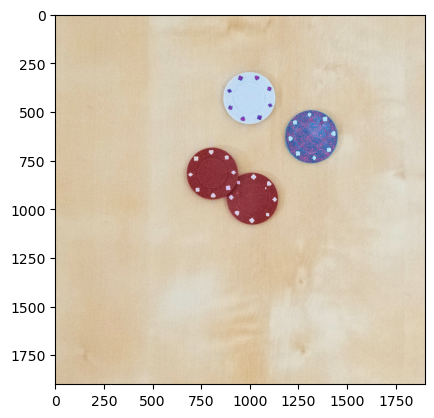

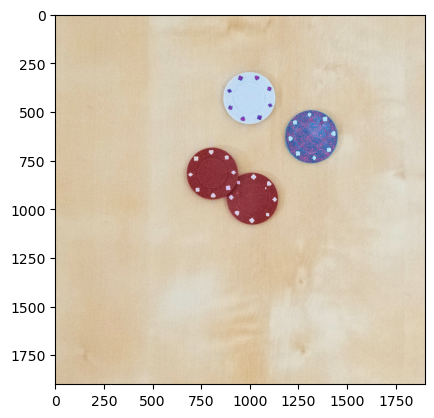

...

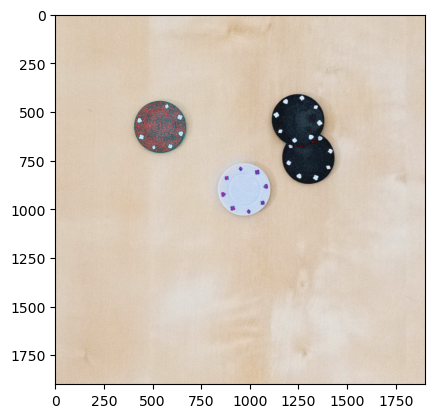

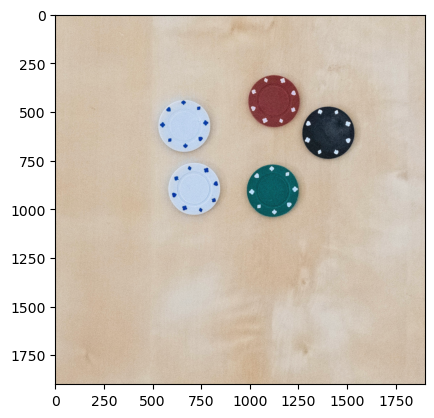

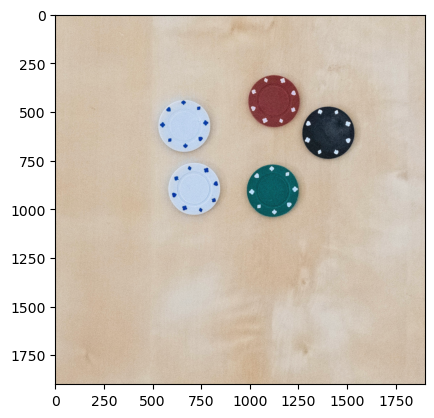

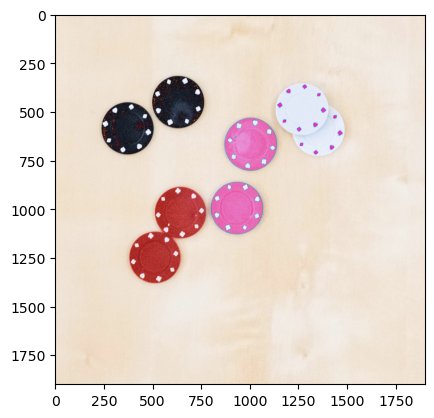

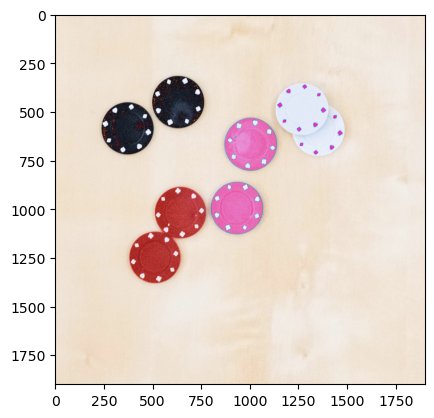

In [ ]:
aligned_colors = []
for c in chips_imgs:
    
    gray = cv2.cvtColor(c, cv2.COLOR_BGR2GRAY)
    flag, thresh = cv2.threshold(gray, 0, 255, cv2.THRESH_OTSU)

    bin_tresh = thresh > 0

    c_mean_background = c[bin_tresh].mean(axis=0)
    
    cc = c.copy()
    cc = (cc - (c_mean_background - ref).astype(int))
    
    cc = (cc / cc.max(axis=(0, 1)) * 255).astype(int)
    cc = cc.astype("uint8")
    
    aligned_colors.append(cc)
    plt.imshow(cc)
    plt.show()

In [ ]:
# TODO convert int64 to unint8

### Manual Treshold Fine-tuning

In [71]:
def concat_imgs(imgs):
    #Create overall image by concatenating 25 out of 28 partitions
    chips_all = None
    for i in range(5):
        chips_row = None
        for j in range(5):
            chips = imgs[i*5+j]
            if(type(chips_row)==type(None)):
                chips_row = chips
            else:
                chips_row = np.concatenate([chips_row,chips],axis=1)
        if(type(chips_all)==type(None)):
            chips_all = chips_row
        else:
            chips_all = np.concatenate([chips_all,chips_row],axis=0)

        chips_row = None

    chips_all = cv2.medianBlur(chips_all,ksize=51)
    plt.imshow(chips_all)
    plt.show()

    chips_reduced = cv2.resize(chips_all, (2000,2000), interpolation = cv2.INTER_AREA)
    plt.imshow(chips_reduced)
    plt.show()
    
    return chips_reduced

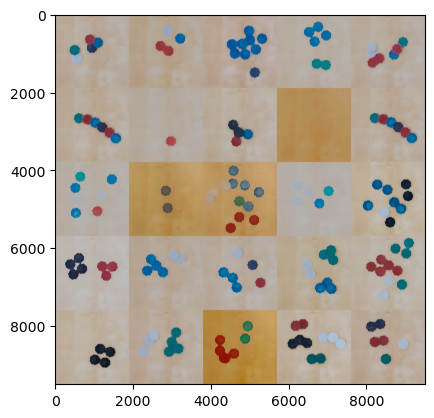

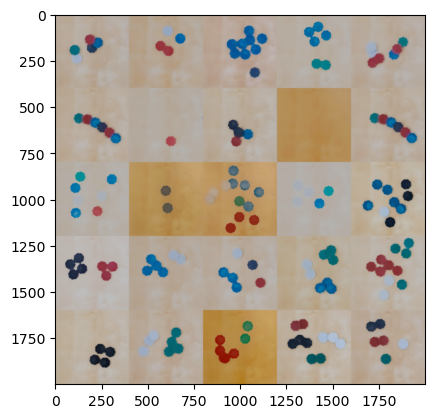

In [72]:
chips_reduced = concat_imgs(aligned_norm_bright)

In [73]:
from PIL import Image
Image.fromarray(chips_reduced).save("aligned_bright_chips.png")